<h1>Содержание<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Подготовка-данных" data-toc-modified-id="Подготовка-данных-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Подготовка данных</a></span><ul class="toc-item"><li><span><a href="#Импорт-библиотек-и-чтение-данных" data-toc-modified-id="Импорт-библиотек-и-чтение-данных-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>Импорт библиотек и чтение данных</a></span></li><li><span><a href="#Эффективность-обогащения" data-toc-modified-id="Эффективность-обогащения-1.2"><span class="toc-item-num">1.2&nbsp;&nbsp;</span>Эффективность обогащения</a></span></li><li><span><a href="#Анализ-признаков-недоступных-в-тестовой-выборке" data-toc-modified-id="Анализ-признаков-недоступных-в-тестовой-выборке-1.3"><span class="toc-item-num">1.3&nbsp;&nbsp;</span>Анализ признаков недоступных в тестовой выборке</a></span></li><li><span><a href="#Предобработка-данных" data-toc-modified-id="Предобработка-данных-1.4"><span class="toc-item-num">1.4&nbsp;&nbsp;</span>Предобработка данных</a></span></li></ul></li><li><span><a href="#Анализ-данных" data-toc-modified-id="Анализ-данных-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Анализ данных</a></span><ul class="toc-item"><li><span><a href="#Концентрация-металлов-на-различных-этапах-очистки" data-toc-modified-id="Концентрация-металлов-на-различных-этапах-очистки-2.1"><span class="toc-item-num">2.1&nbsp;&nbsp;</span>Концентрация металлов на различных этапах очистки</a></span></li><li><span><a href="#Распределение-размеров-гранул-сырья" data-toc-modified-id="Распределение-размеров-гранул-сырья-2.2"><span class="toc-item-num">2.2&nbsp;&nbsp;</span>Распределение размеров гранул сырья</a></span></li><li><span><a href="#Суммарная-концентрация-всех-веществ" data-toc-modified-id="Суммарная-концентрация-всех-веществ-2.3"><span class="toc-item-num">2.3&nbsp;&nbsp;</span>Суммарная концентрация всех веществ</a></span></li></ul></li><li><span><a href="#Модель" data-toc-modified-id="Модель-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Модель</a></span><ul class="toc-item"><li><span><a href="#Функция-для-расчета-SMAPE" data-toc-modified-id="Функция-для-расчета-SMAPE-3.1"><span class="toc-item-num">3.1&nbsp;&nbsp;</span>Функция для расчета SMAPE</a></span></li><li><span><a href="#Формирование-фич-и-таргетов-для-обучения-модели" data-toc-modified-id="Формирование-фич-и-таргетов-для-обучения-модели-3.2"><span class="toc-item-num">3.2&nbsp;&nbsp;</span>Формирование фич и таргетов для обучения модели</a></span></li><li><span><a href="#Обучение-линейной-модели" data-toc-modified-id="Обучение-линейной-модели-3.3"><span class="toc-item-num">3.3&nbsp;&nbsp;</span>Обучение линейной модели</a></span></li><li><span><a href="#Обучение-константной-модели-(DummyRegressor)" data-toc-modified-id="Обучение-константной-модели-(DummyRegressor)-3.4"><span class="toc-item-num">3.4&nbsp;&nbsp;</span>Обучение константной модели (DummyRegressor)</a></span></li><li><span><a href="#Модель-RandomForestRegressor" data-toc-modified-id="Модель-RandomForestRegressor-3.5"><span class="toc-item-num">3.5&nbsp;&nbsp;</span>Модель RandomForestRegressor</a></span></li><li><span><a href="#Проверка-на-тестовой-выборке" data-toc-modified-id="Проверка-на-тестовой-выборке-3.6"><span class="toc-item-num">3.6&nbsp;&nbsp;</span>Проверка на тестовой выборке</a></span></li></ul></li><li><span><a href="#Вывод" data-toc-modified-id="Вывод-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Вывод</a></span></li></ul></div>

# Восстановление золота из руды

Необходимо подготовить прототип модели машинного обучения для «Цифры». Компания разрабатывает решения для эффективной работы промышленных предприятий.

Модель должна предсказать коэффициент восстановления золота из золотосодержащей руды. 

Модель поможет оптимизировать производство, чтобы не запускать предприятие с убыточными характеристиками.

Задачи:

1. Подготовить данные;
2. Провести исследовательский анализ данных;
3. Построить и обучить модель.

# Описание процесса 

Когда добытая руда проходит первичную обработку, получается дроблёная смесь. Её отправляют на флотацию (обогащение) и двухэтапную очистку.

1. Флотация

Во флотационную установку подаётся смесь золотосодержащей руды. После обогащения получается черновой концентрат и «отвальные хвосты», то есть остатки продукта с низкой концентрацией ценных металлов.
На стабильность этого процесса влияет непостоянное и неоптимальное физико-химическое состояние флотационной пульпы (смеси твёрдых частиц и жидкости).

2. Очистка

Черновой концентрат проходит две очистки. На выходе получается финальный концентрат и новые отвальные хвосты.

## Подготовка данных

### Импорт библиотек и чтение данных

In [1]:
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
import numpy as np


from sklearn.metrics import mean_absolute_error
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score
from sklearn.metrics import make_scorer
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor

In [2]:
df_train = pd.read_csv('https://code.s3.yandex.net/datasets/gold_recovery_train_new.csv')
df_test = pd.read_csv('https://code.s3.yandex.net//datasets/gold_recovery_test_new.csv')
df_full = pd.read_csv('https://code.s3.yandex.net//datasets/gold_recovery_full_new.csv') 

Ознакомимся с данными

In [3]:
display('Обучающая выборка', df_train.head(), 
        'Тестовая выборка', df_test.head(), 
        'Исходная выборка', df_full.head())

'Обучающая выборка'

,date,final.output.concentrate_ag,final.output.concentrate_pb,final.output.concentrate_sol,final.output.concentrate_au,final.output.recovery,final.output.tail_ag,final.output.tail_pb,final.output.tail_sol,final.output.tail_au,...,secondary_cleaner.state.floatbank4_a_air,secondary_cleaner.state.floatbank4_a_level,secondary_cleaner.state.floatbank4_b_air,secondary_cleaner.state.floatbank4_b_level,secondary_cleaner.state.floatbank5_a_air,secondary_cleaner.state.floatbank5_a_level,secondary_cleaner.state.floatbank5_b_air,secondary_cleaner.state.floatbank5_b_level,secondary_cleaner.state.floatbank6_a_air,secondary_cleaner.state.floatbank6_a_level
0,2016-01-15 00:00:00,6.055403,9.889648,5.507324,42.192020,70.541216,10.411962,0.895447,16.904297,2.143149,...,14.016835,-502.488007,12.099931,-504.715942,9.925633,-498.310211,8.079666,-500.470978,14.151341,-605.841980
1,2016-01-15 01:00:00,6.029369,9.968944,5.257781,42.701629,69.266198,10.462676,0.927452,16.634514,2.224930,...,13.992281,-505.503262,11.950531,-501.331529,10.039245,-500.169983,7.984757,-500.582168,13.998353,-599.787184
2,2016-01-15 02:00:00,6.055926,10.213995,5.383759,42.657501,68.116445,10.507046,0.953716,16.208849,2.257889,...,14.015015,-502.520901,11.912783,-501.133383,10.070913,-500.129135,8.013877,-500.517572,14.028663,-601.427363
3,2016-01-15 03:00:00,6.047977,9.977019,4.858634,42.689819,68.347543,10.422762,0.883763,16.532835,2.146849,...,14.036510,-500.857308,11.999550,-501.193686,9.970366,-499.201640,7.977324,-500.255908,14.005551,-599.996129
4,2016-01-15 04:00:00,6.148599,10.142511,4.939416,42.774141,66.927016,10.360302,0.792826,16.525686,2.055292,...,14.027298,-499.838632,11.953070,-501.053894,9.925709,-501.686727,7.894242,-500.356035,13.996647,-601.496691


'Тестовая выборка'

,date,primary_cleaner.input.sulfate,primary_cleaner.input.depressant,primary_cleaner.input.feed_size,primary_cleaner.input.xanthate,primary_cleaner.state.floatbank8_a_air,primary_cleaner.state.floatbank8_a_level,primary_cleaner.state.floatbank8_b_air,primary_cleaner.state.floatbank8_b_level,primary_cleaner.state.floatbank8_c_air,...,secondary_cleaner.state.floatbank4_a_air,secondary_cleaner.state.floatbank4_a_level,secondary_cleaner.state.floatbank4_b_air,secondary_cleaner.state.floatbank4_b_level,secondary_cleaner.state.floatbank5_a_air,secondary_cleaner.state.floatbank5_a_level,secondary_cleaner.state.floatbank5_b_air,secondary_cleaner.state.floatbank5_b_level,secondary_cleaner.state.floatbank6_a_air,secondary_cleaner.state.floatbank6_a_level
0,2016-09-01 00:59:59,210.800909,14.993118,8.080000,1.005021,1398.981301,-500.225577,1399.144926,-499.919735,1400.102998,...,12.023554,-497.795834,8.016656,-501.289139,7.946562,-432.317850,4.872511,-500.037437,26.705889,-499.709414
1,2016-09-01 01:59:59,215.392455,14.987471,8.080000,0.990469,1398.777912,-500.057435,1398.055362,-499.778182,1396.151033,...,12.058140,-498.695773,8.130979,-499.634209,7.958270,-525.839648,4.878850,-500.162375,25.019940,-499.819438
2,2016-09-01 02:59:59,215.259946,12.884934,7.786667,0.996043,1398.493666,-500.868360,1398.860436,-499.764529,1398.075709,...,11.962366,-498.767484,8.096893,-500.827423,8.071056,-500.801673,4.905125,-499.828510,24.994862,-500.622559
3,2016-09-01 03:59:59,215.336236,12.006805,7.640000,0.863514,1399.618111,-498.863574,1397.440120,-499.211024,1400.129303,...,12.033091,-498.350935,8.074946,-499.474407,7.897085,-500.868509,4.931400,-499.963623,24.948919,-498.709987
4,2016-09-01 04:59:59,199.099327,10.682530,7.530000,0.805575,1401.268123,-500.808305,1398.128818,-499.504543,1402.172226,...,12.025367,-500.786497,8.054678,-500.397500,8.107890,-509.526725,4.957674,-500.360026,25.003331,-500.856333


'Исходная выборка'

,date,final.output.concentrate_ag,final.output.concentrate_pb,final.output.concentrate_sol,final.output.concentrate_au,final.output.recovery,final.output.tail_ag,final.output.tail_pb,final.output.tail_sol,final.output.tail_au,...,secondary_cleaner.state.floatbank4_a_air,secondary_cleaner.state.floatbank4_a_level,secondary_cleaner.state.floatbank4_b_air,secondary_cleaner.state.floatbank4_b_level,secondary_cleaner.state.floatbank5_a_air,secondary_cleaner.state.floatbank5_a_level,secondary_cleaner.state.floatbank5_b_air,secondary_cleaner.state.floatbank5_b_level,secondary_cleaner.state.floatbank6_a_air,secondary_cleaner.state.floatbank6_a_level
0,2016-01-15 00:00:00,6.055403,9.889648,5.507324,42.192020,70.541216,10.411962,0.895447,16.904297,2.143149,...,14.016835,-502.488007,12.099931,-504.715942,9.925633,-498.310211,8.079666,-500.470978,14.151341,-605.841980
1,2016-01-15 01:00:00,6.029369,9.968944,5.257781,42.701629,69.266198,10.462676,0.927452,16.634514,2.224930,...,13.992281,-505.503262,11.950531,-501.331529,10.039245,-500.169983,7.984757,-500.582168,13.998353,-599.787184
2,2016-01-15 02:00:00,6.055926,10.213995,5.383759,42.657501,68.116445,10.507046,0.953716,16.208849,2.257889,...,14.015015,-502.520901,11.912783,-501.133383,10.070913,-500.129135,8.013877,-500.517572,14.028663,-601.427363
3,2016-01-15 03:00:00,6.047977,9.977019,4.858634,42.689819,68.347543,10.422762,0.883763,16.532835,2.146849,...,14.036510,-500.857308,11.999550,-501.193686,9.970366,-499.201640,7.977324,-500.255908,14.005551,-599.996129
4,2016-01-15 04:00:00,6.148599,10.142511,4.939416,42.774141,66.927016,10.360302,0.792826,16.525686,2.055292,...,14.027298,-499.838632,11.953070,-501.053894,9.925709,-501.686727,7.894242,-500.356035,13.996647,-601.496691


In [4]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14149 entries, 0 to 14148
Data columns (total 87 columns):
 #   Column                                              Non-Null Count  Dtype  
---  ------                                              --------------  -----  
 0   date                                                14149 non-null  object 
 1   final.output.concentrate_ag                         14148 non-null  float64
 2   final.output.concentrate_pb                         14148 non-null  float64
 3   final.output.concentrate_sol                        13938 non-null  float64
 4   final.output.concentrate_au                         14149 non-null  float64
 5   final.output.recovery                               14149 non-null  float64
 6   final.output.tail_ag                                14149 non-null  float64
 7   final.output.tail_pb                                14049 non-null  float64
 8   final.output.tail_sol                               14144 non-null  float64


In [5]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5290 entries, 0 to 5289
Data columns (total 53 columns):
 #   Column                                      Non-Null Count  Dtype  
---  ------                                      --------------  -----  
 0   date                                        5290 non-null   object 
 1   primary_cleaner.input.sulfate               5286 non-null   float64
 2   primary_cleaner.input.depressant            5285 non-null   float64
 3   primary_cleaner.input.feed_size             5290 non-null   float64
 4   primary_cleaner.input.xanthate              5286 non-null   float64
 5   primary_cleaner.state.floatbank8_a_air      5290 non-null   float64
 6   primary_cleaner.state.floatbank8_a_level    5290 non-null   float64
 7   primary_cleaner.state.floatbank8_b_air      5290 non-null   float64
 8   primary_cleaner.state.floatbank8_b_level    5290 non-null   float64
 9   primary_cleaner.state.floatbank8_c_air      5290 non-null   float64
 10  primary_clea

In [6]:
df_full.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19439 entries, 0 to 19438
Data columns (total 87 columns):
 #   Column                                              Non-Null Count  Dtype  
---  ------                                              --------------  -----  
 0   date                                                19439 non-null  object 
 1   final.output.concentrate_ag                         19438 non-null  float64
 2   final.output.concentrate_pb                         19438 non-null  float64
 3   final.output.concentrate_sol                        19228 non-null  float64
 4   final.output.concentrate_au                         19439 non-null  float64
 5   final.output.recovery                               19439 non-null  float64
 6   final.output.tail_ag                                19438 non-null  float64
 7   final.output.tail_pb                                19338 non-null  float64
 8   final.output.tail_sol                               19433 non-null  float64


__Описание данных__

Итак для удобства и дальнейшей работы изобразим процесс флотации и очистки в виде блок схемы. 

На карте изображены три основных процесса - Флотация и две ступени очистки. 

Данная карта в ближайшем будущем поможет разобраться с самим процессом, да и формированием фич.

В тестовой выборке доступны все признаки за исключением выходных параметров, а также расчетных (отмечены красным)

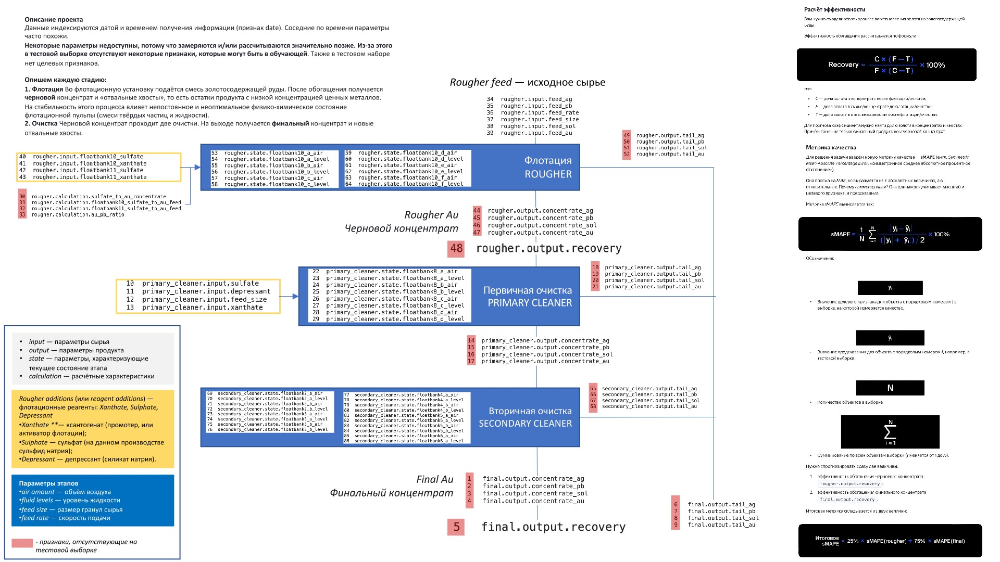

### Эффективность обогащения

In [7]:
# C — доля золота в концентрате после флотации/очистки;
C = df_train['rougher.output.concentrate_au']
# F — доля золота в сырье/концентрате до флотации/очистки;
F = df_train['rougher.input.feed_au']
# T — доля золота в отвальных хвостах после флотации/очистки.
T = df_train['rougher.output.tail_au']

# Расчет эффективности обогащения
df_train['rougher.output.recovery.calculation'] = C * (F - T) / (F * (C - T)) * 100

In [8]:
fig = go.Figure()

fig.add_trace(go.Scatter(x = df_train['date'], y = df_train['rougher.output.recovery'], 
                         mode='markers', marker_symbol = 'circle', marker_size = 5, name = 'Эффективность обогащения'))
fig.add_trace(go.Scatter(x = df_train['date'], y = df_train['rougher.output.recovery.calculation'], 
                         mode='markers', marker_symbol = 'circle', marker_size = 2, name = 'Расчетная эффективность обогащения', opacity = 1))

fig.show()

In [9]:
mae = mean_absolute_error(df_train['rougher.output.recovery'], df_train['rougher.output.recovery.calculation'])
mae

9.73512347450521e-15

Метрика МАЕ достаточно мала, да и по графику видно, что эффективность обогащения в обучающей выборке корректная (сходится с расчетными)

 ### Анализ признаков недоступных в тестовой выборке

In [10]:
# сформируем признаки, которых нет в тестовой выборке
names_columns_for_drop = set(df_train.columns) - set(df_test.columns)
names_columns_for_drop

{'final.output.concentrate_ag',
 'final.output.concentrate_au',
 'final.output.concentrate_pb',
 'final.output.concentrate_sol',
 'final.output.recovery',
 'final.output.tail_ag',
 'final.output.tail_au',
 'final.output.tail_pb',
 'final.output.tail_sol',
 'primary_cleaner.output.concentrate_ag',
 'primary_cleaner.output.concentrate_au',
 'primary_cleaner.output.concentrate_pb',
 'primary_cleaner.output.concentrate_sol',
 'primary_cleaner.output.tail_ag',
 'primary_cleaner.output.tail_au',
 'primary_cleaner.output.tail_pb',
 'primary_cleaner.output.tail_sol',
 'rougher.calculation.au_pb_ratio',
 'rougher.calculation.floatbank10_sulfate_to_au_feed',
 'rougher.calculation.floatbank11_sulfate_to_au_feed',
 'rougher.calculation.sulfate_to_au_concentrate',
 'rougher.output.concentrate_ag',
 'rougher.output.concentrate_au',
 'rougher.output.concentrate_pb',
 'rougher.output.concentrate_sol',
 'rougher.output.recovery',
 'rougher.output.recovery.calculation',
 'rougher.output.tail_ag',
 'roug

В тестовой выборке недоступны характеристики выходного продукта, а именно:
1. концентрата и отвального хвоста после флотации (rougher.output), а так же расчетных характеристик флотации
2. концентрата и отвального хвоста после первичной очистки (primary_cleaner.output)
3. отвального хвоста после вторичной очистки (secondary_cleaner.output)
4. концентрата и отвального хвоста после финальной очистки (final.output)

В целом отсутвующие на тестовой выборке признаки ранее отмечались на карте в пункте 1.1.

Это и логично, потому что, отсутствующие признаки являются результатами процесса (прогнозыми) и фактически у нас нет возможности передать их в модель.

### Предобработка данных

Восстановим пропуски в данных руководствуясь тем, что соседние по времени параметры часто похожи.

In [11]:
df_train = df_train.fillna(method = 'bfill', axis = 0)
df_full = df_full.fillna(method = 'bfill', axis = 0)

Удалим из тестовой выборке строки с пропусками

In [12]:
df_test.dropna(inplace = True)

## Анализ данных

### Концентрация металлов на различных этапах очистки

Посмотрим, как меняется концентрация металлов (Au, Ag, Pb) на различных этапах очистки

In [13]:
fig = go.Figure()

fig.add_trace(go.Box(x = df_full['rougher.input.feed_sol'], name = 'Sol до флотации', marker_color = '#548cb1'))
fig.add_trace(go.Box(x = df_full['rougher.output.concentrate_sol'], name = 'Sol после флотации', marker_color = '#548cb1'))
fig.add_trace(go.Box(x = df_full['primary_cleaner.output.concentrate_sol'], name = 'Sol после первичной очистки', marker_color = '#548cb1'))
fig.add_trace(go.Box(x = df_full['final.output.concentrate_sol'], name = 'Sol после вторичной очистки', marker_color = '#548cb1'))

fig.add_trace(go.Box(x = df_full['rougher.input.feed_pb'], name = 'Pb до флотации', marker_color = '#FF851B'))
fig.add_trace(go.Box(x = df_full['rougher.output.concentrate_pb'], name = 'Pb после флотации', marker_color = '#FF851B'))
fig.add_trace(go.Box(x = df_full['primary_cleaner.output.concentrate_pb'], name = 'Pb после первичной очистки', marker_color = '#FF851B'))
fig.add_trace(go.Box(x = df_full['final.output.concentrate_pb'], name = 'Pb после вторичной очистки', marker_color = '#FF851B'))

fig.add_trace(go.Box(x = df_full['rougher.input.feed_ag'], name = 'Ag до флотации', marker_color = '#FF4136'))
fig.add_trace(go.Box(x = df_full['rougher.output.concentrate_ag'], name = 'Ag после флотации', marker_color = '#FF4136'))
fig.add_trace(go.Box(x = df_full['primary_cleaner.output.concentrate_ag'], name = 'Ag после первичной очистки', marker_color = '#FF4136'))
fig.add_trace(go.Box(x = df_full['final.output.concentrate_ag'], name = 'Ag после вторичной очистки', marker_color = '#FF4136'))

fig.add_trace(go.Box(x = df_full['rougher.input.feed_au'], name = 'Au до флотации', marker_color = '#3D9970'))
fig.add_trace(go.Box(x = df_full['rougher.output.concentrate_au'], name = 'Au после флотации', marker_color = '#3D9970'))
fig.add_trace(go.Box(x = df_full['primary_cleaner.output.concentrate_au'], name = 'Au после первичной очистки', marker_color = '#3D9970'))
fig.add_trace(go.Box(x = df_full['final.output.concentrate_au'], name = 'Au после вторичной очистки', marker_color = '#3D9970'))


fig.update_layout(title = 'Концентрация металлов в концентратах',
                 width = 1000,
                 height = 800)

fig.update_traces(opacity=0.75)
fig.show()

__Вывод:__

- Медианное значение концентрации золота в результате флотации повышается __с 8 % до 20 %__, свинца с 4 до 8%, серебра с 9% до 12%
- Двухступенчатая очистка повышает концентрацию золота __до 45%__, свинца до 10%, серебра снижает до 5%
- Каждый из этапов снижает сопутствующие элементы, такие как реагенты. Итак sol снизился за весь цикл с 37% до 9%

In [14]:
fig = go.Figure()

fig.add_trace(go.Box(x = df_full['rougher.output.tail_sol'], name = 'Sol после флотации', marker_color = '#548cb1'))
fig.add_trace(go.Box(x = df_full['primary_cleaner.output.tail_sol'], name = 'Sol после первичной очистки', marker_color = '#548cb1'))
fig.add_trace(go.Box(x = df_full['secondary_cleaner.output.tail_sol'], name = 'Sol после вторичной очистки', marker_color = '#548cb1'))
fig.add_trace(go.Box(x = df_full['final.output.tail_sol'], name = 'Sol final', marker_color = '#548cb1'))

fig.add_trace(go.Box(x = df_full['rougher.output.tail_pb'], name = 'Pb после флотации', marker_color = '#FF851B'))
fig.add_trace(go.Box(x = df_full['primary_cleaner.output.tail_pb'], name = 'Pb после первичной очистки', marker_color = '#FF851B'))
fig.add_trace(go.Box(x = df_full['secondary_cleaner.output.tail_pb'], name = 'Pb после вторичной очистки', marker_color = '#FF851B'))
fig.add_trace(go.Box(x = df_full['final.output.tail_pb'], name = 'Pb final', marker_color = '#FF851B'))

fig.add_trace(go.Box(x = df_full['rougher.output.tail_ag'], name = 'Ag после флотации', marker_color = '#FF4136'))
fig.add_trace(go.Box(x = df_full['primary_cleaner.output.tail_ag'], name = 'Ag после первичной очистки', marker_color = '#FF4136'))
fig.add_trace(go.Box(x = df_full['secondary_cleaner.output.tail_ag'], name = 'Ag после вторичной очистки', marker_color = '#FF4136'))
fig.add_trace(go.Box(x = df_full['final.output.tail_ag'], name = 'Ag final', marker_color = '#FF4136'))

fig.add_trace(go.Box(x = df_full['rougher.output.tail_au'], name = 'Au после флотации', marker_color = '#3D9970'))
fig.add_trace(go.Box(x = df_full['primary_cleaner.output.tail_au'], name = 'Au после первичной очистки', marker_color = '#3D9970'))
fig.add_trace(go.Box(x = df_full['secondary_cleaner.output.tail_au'], name = 'Au после вторичной очистки', marker_color = '#3D9970'))
fig.add_trace(go.Box(x = df_full['final.output.tail_au'], name = 'Au final', marker_color = '#3D9970'))


fig.update_layout(title = 'Концентрация металлов в отвальных хвостах', xaxis_range=[0,25],
                 width = 1000,
                 height = 800)

fig.update_traces(opacity=0.75)
fig.show()

__Вывод:__

- Медианное значение концентрации золота в отвальном хвосте в результате флотации составляет __2 %__, свинца 1%, серебра 5%
- В результате очистки концентрация золота в отвальнои хвосте держится в диапазоне 3-4 %

- Остаток драгоценных металлов можно рассматривать как апсайд к вопросу тонкости очистки

### Распределение размеров гранул сырья

Рассмотрим распределения размеров гранул сырья на обучающей и тестовой выборках.

Если распределения сильно отличаются друг от друга, оценка модели будет неправильной.

In [15]:
fig = go.Figure()

fig.add_trace(go.Box(y = df_test['rougher.input.feed_size'], name = 'до флотации (обучающая выборка)', marker_color = '#3D9970'))
fig.add_trace(go.Box(y = df_train['rougher.input.feed_size'], name = 'до флотации (тестовая выборка)', marker_color = '#FF4136'))

fig.add_trace(go.Box(y = df_test['primary_cleaner.input.feed_size'], name = 'до первичной очистки (обучающая выборка)', marker_color = '#3D9970'))
fig.add_trace(go.Box(y = df_train['primary_cleaner.input.feed_size'], name = 'до первичной очистки (тестовая выборка)', marker_color = '#FF4136'))

fig.update_layout(title = 'Размер гранул сырья', yaxis_range=[0,100])
# Reduce opacity to see both histograms
fig.update_traces(opacity=0.75)
fig.show()

In [16]:
fig = go.Figure()

fig.add_trace(go.Histogram(x = df_train['rougher.input.feed_size'], name = 'до флотации (тестовая выборка)', marker_color = '#FF4136'))
fig.add_trace(go.Histogram(x = df_test['rougher.input.feed_size'], name = 'до флотации (обучающая выборка)', marker_color = '#3D9970'))

fig.add_trace(go.Histogram(x = df_train['primary_cleaner.input.feed_size'], name = 'до первичной очистки (тестовая выборка)', marker_color = '#FF4136'))
fig.add_trace(go.Histogram(x = df_test['primary_cleaner.input.feed_size'], name = 'до первичной очистки (обучающая выборка)', marker_color = '#3D9970'))

fig.update_layout(title = 'Размер гранул сырья', barmode='overlay', xaxis_range = [0, 100])
fig.update_traces(opacity=0.5)

fig.show()

В целом распределения размеров гранул сопоставимы и в обучающей и в тестовой выборках

### Суммарная концентрация всех веществ

Исследование концентраций в сырье

In [17]:
df_full['rougher.input.all_concentrate'] = df_full['rougher.input.feed_au'] + df_full['rougher.input.feed_ag'] + df_full['rougher.input.feed_pb'] + df_full['rougher.input.feed_sol']
df_train['rougher.input.all_concentrate'] = df_train['rougher.input.feed_au'] + df_train['rougher.input.feed_ag'] + df_train['rougher.input.feed_pb'] + df_train['rougher.input.feed_sol']
df_test['rougher.input.all_concentrate'] = df_test['rougher.input.feed_au'] + df_test['rougher.input.feed_ag'] + df_test['rougher.input.feed_pb'] + df_test['rougher.input.feed_sol']

In [18]:
fig = go.Figure()

fig.add_trace(go.Histogram(x = df_full['rougher.input.all_concentrate'], 
                           name = 'Полная выборка', marker_color = '#FF4136'))
fig.add_trace(go.Histogram(x = df_train['rougher.input.all_concentrate'], 
                           name = 'Обучающая выборка', marker_color = '#3D9970'))
fig.add_trace(go.Histogram(x = df_test['rougher.input.all_concentrate'], 
                           name = 'Тестовая выборка', marker_color = '#548cb1'))


fig.update_layout(title = 'Суммарная концентрация входного сырья', barmode='overlay', xaxis_range = [0, 100])
fig.update_traces(opacity=0.5)

fig.show()

Аномалии отсутствуют.В среднем доля примесей на входе составляет порядка 40%

__Исследование суммарной концентрации на выходе из флотационной установки__

На тестововой выборке ожидаемо нет результатов на выходе из флотационной установки

In [19]:
df_full['rougher.output.all_concentrate'] = df_full['rougher.output.concentrate_au'] + df_full['rougher.output.concentrate_ag'] + df_full['rougher.output.concentrate_pb'] + df_full['rougher.output.concentrate_sol']
df_train['rougher.output.all_concentrate'] = df_train['rougher.output.concentrate_au'] + df_train['rougher.output.concentrate_ag'] + df_train['rougher.output.concentrate_pb'] + df_train['rougher.output.concentrate_sol'] 

In [20]:
fig = go.Figure()

fig.add_trace(go.Histogram(x = df_train['rougher.output.all_concentrate'], 
                           name = 'Обучающая выборка', marker_color = '#3D9970'))
fig.add_trace(go.Histogram(x = df_full['rougher.output.all_concentrate'], 
                           name = 'Полная выборка', marker_color = '#FF4136'))

fig.update_layout(title = 'Суммарная концентрация выходного сырья', barmode='overlay', xaxis_range = [0, 100])
fig.update_traces(opacity=0.5)

fig.show()

Можем ли удалить выбросы в райне нуля процентов. Скорее да, чем нет. Связано это с тем, что на выходе из флотационной установки в любом случае доля металлов не может составлять 0% (смелое заявление, не эксперт, но было бы странно утверждать обратное).

In [21]:
df_train= df_train[df_train['rougher.output.all_concentrate'] != 0]

__Рассмотрим финальные концентрации__

In [22]:
df_full['final.output.all_concentrate'] = df_full['final.output.concentrate_au'] + df_full['final.output.concentrate_ag'] + df_full['final.output.concentrate_sol'] + df_full['final.output.concentrate_pb']
df_train['final.output.all_concentrate'] = df_train['final.output.concentrate_au'] + df_train['final.output.concentrate_ag'] + df_train['final.output.concentrate_sol'] + df_train['final.output.concentrate_pb']

In [23]:
fig = go.Figure()

fig.add_trace(go.Histogram(x = df_train['final.output.all_concentrate'], 
                           name = 'Обучающая выборка', marker_color = '#3D9970'))
fig.add_trace(go.Histogram(x = df_full['final.output.all_concentrate'], 
                           name = 'Полная выборка', marker_color = '#FF4136'))

fig.update_layout(title = 'Суммарная концентрация финальной концентрации', barmode='overlay', xaxis_range = [0, 100])
fig.update_traces(opacity=0.5)

fig.show()

In [24]:
df_train = df_train[df_train['final.output.all_concentrate'] != 0]

## Модель


### Функция для расчета SMAPE

In [25]:
def smape_score(predictions, target):
    smape = 100 * 2 / len(target) * np.sum(abs(predictions - target) / (abs(predictions) + abs(target)))
    return smape

scorer = make_scorer(smape_score, greater_is_better = False)

### Формирование фич и таргетов для обучения модели

Сформируем фичи для обучения модели для прогноза эффективности обогащения чернового концентрата

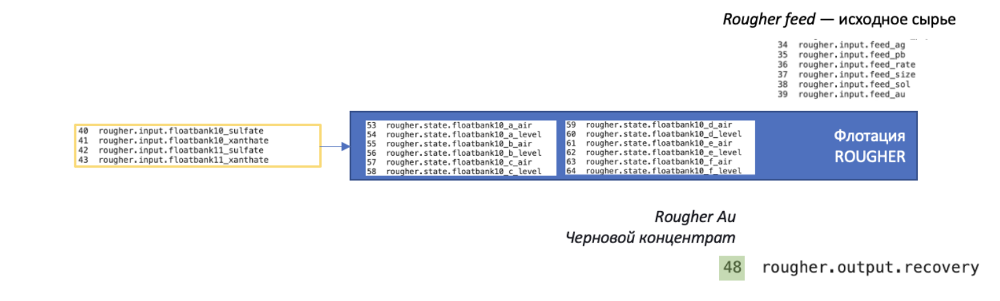

In [26]:
rougher_features_columns = [
        # параметры сырья
        'rougher.input.feed_ag', 'rougher.input.feed_pb', 'rougher.input.feed_rate',  
        'rougher.input.feed_size',  'rougher.input.feed_sol', 'rougher.input.feed_au',
        # параметры реагентов
        'rougher.input.floatbank10_sulfate', 'rougher.input.floatbank10_xanthate', 
        'rougher.input.floatbank11_sulfate', 'rougher.input.floatbank11_xanthate',
        # параметры флотации
        'rougher.state.floatbank10_a_air', 'rougher.state.floatbank10_a_level', 
        'rougher.state.floatbank10_b_air', 'rougher.state.floatbank10_b_level', 
        'rougher.state.floatbank10_c_air', 'rougher.state.floatbank10_c_level', 
        'rougher.state.floatbank10_d_air', 'rougher.state.floatbank10_d_level',
        'rougher.state.floatbank10_e_air', 'rougher.state.floatbank10_e_level', 
        'rougher.state.floatbank10_f_air', 'rougher.state.floatbank10_f_level'
        ]

rougher_features = df_train[rougher_features_columns]
rougher_features_test = df_test[rougher_features_columns]

In [27]:
# Стандартизация фич
scaler = StandardScaler()
scaler.fit(df_train[rougher_features_columns])

rougher_features[rougher_features_columns] = scaler.transform(df_train[rougher_features_columns])
rougher_features_test[rougher_features_columns] = scaler.transform(df_test[rougher_features_columns])

/Users/vladimirgavrilev/opt/anaconda3/lib/python3.9/site-packages/pandas/core/frame.py:3678: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/Users/vladimirgavrilev/opt/anaconda3/lib/python3.9/site-packages/pandas/core/frame.py:3678: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [28]:
# Результаты стандартизации
display(rougher_features.head(), rougher_features_test.head())

,rougher.input.feed_ag,rougher.input.feed_pb,rougher.input.feed_rate,rougher.input.feed_size,rougher.input.feed_sol,rougher.input.feed_au,rougher.input.floatbank10_sulfate,rougher.input.floatbank10_xanthate,rougher.input.floatbank11_sulfate,rougher.input.floatbank11_xanthate,...,rougher.state.floatbank10_b_air,rougher.state.floatbank10_b_level,rougher.state.floatbank10_c_air,rougher.state.floatbank10_c_level,rougher.state.floatbank10_d_air,rougher.state.floatbank10_d_level,rougher.state.floatbank10_e_air,rougher.state.floatbank10_e_level,rougher.state.floatbank10_f_air,rougher.state.floatbank10_f_level
0,-1.305803,-1.116327,0.466700,-0.192520,0.103811,-0.712455,0.087803,0.122476,0.133426,0.168682,...,1.537764,0.512810,1.415902,0.407294,1.844940,0.252656,1.653157,0.165069,2.160192,0.223192
1,-1.273673,-1.133658,0.483569,-0.115792,-0.108126,-0.716398,0.083045,0.120452,0.176302,0.173421,...,1.525366,0.247108,1.406965,0.270669,1.852551,0.276744,1.625346,0.246305,2.065335,0.255381
2,-1.297298,-1.231343,0.529372,-0.105859,-0.064292,-0.777035,0.067437,0.294773,0.155900,0.307730,...,1.517579,0.246147,1.403160,0.268450,1.849305,0.276735,1.625102,0.262793,2.068740,0.248165
3,-1.335993,-1.343169,0.650880,-0.093782,0.114586,-0.904205,-0.022191,0.300050,0.094618,0.302096,...,1.521546,0.235486,1.404764,0.269239,1.839139,0.273573,1.634446,0.261156,2.068273,0.261183
4,-1.326679,-1.573525,0.630972,-0.168518,-0.390463,-1.141042,-0.229620,0.296091,-0.102237,0.300920,...,1.522367,0.253277,1.406390,0.267019,1.848873,0.277532,1.637721,0.281548,2.073550,0.250287


,rougher.input.feed_ag,rougher.input.feed_pb,rougher.input.feed_rate,rougher.input.feed_size,rougher.input.feed_sol,rougher.input.feed_au,rougher.input.floatbank10_sulfate,rougher.input.floatbank10_xanthate,rougher.input.floatbank11_sulfate,rougher.input.floatbank11_xanthate,...,rougher.state.floatbank10_b_air,rougher.state.floatbank10_b_level,rougher.state.floatbank10_c_air,rougher.state.floatbank10_c_level,rougher.state.floatbank10_d_air,rougher.state.floatbank10_d_level,rougher.state.floatbank10_e_air,rougher.state.floatbank10_e_level,rougher.state.floatbank10_f_air,rougher.state.floatbank10_f_level
0,2.412243,1.960625,0.140268,0.116771,1.151007,2.204723,1.610734,0.254837,1.486469,0.270016,...,-0.403121,1.133674,-0.246888,1.174203,-0.072526,1.183606,-0.494301,1.154298,-0.501489,1.173664
1,2.363420,1.859052,0.143274,0.084690,0.983391,2.118673,1.635309,0.114336,1.521041,0.166232,...,-0.410500,1.119053,-0.248001,1.170010,-0.061908,1.175450,-0.491492,1.154996,-0.497875,1.039175
2,2.417450,1.767708,0.138569,0.296311,1.256222,2.208490,1.632220,-0.020683,1.517285,0.062219,...,-0.415745,1.113503,-0.254165,1.144148,-0.065433,1.160209,-0.491898,1.159497,-0.497188,1.126219
3,2.027084,1.481472,0.012843,-0.005018,0.957741,2.255529,1.490185,-0.064985,1.391732,0.027294,...,-0.394418,1.141559,-0.243383,1.167933,-0.067210,1.219286,-0.481266,1.138264,-0.494822,1.144984
4,1.459405,1.162582,0.125320,0.142669,0.999711,1.791126,0.587802,-0.123077,0.621121,-0.017482,...,-0.101388,1.126630,0.020503,1.180403,0.168738,1.158658,-0.179516,1.163897,-0.501037,1.154272


Сформируем фичи для обучения модели прогноза финальной эффективности обогащения в двух вариантах


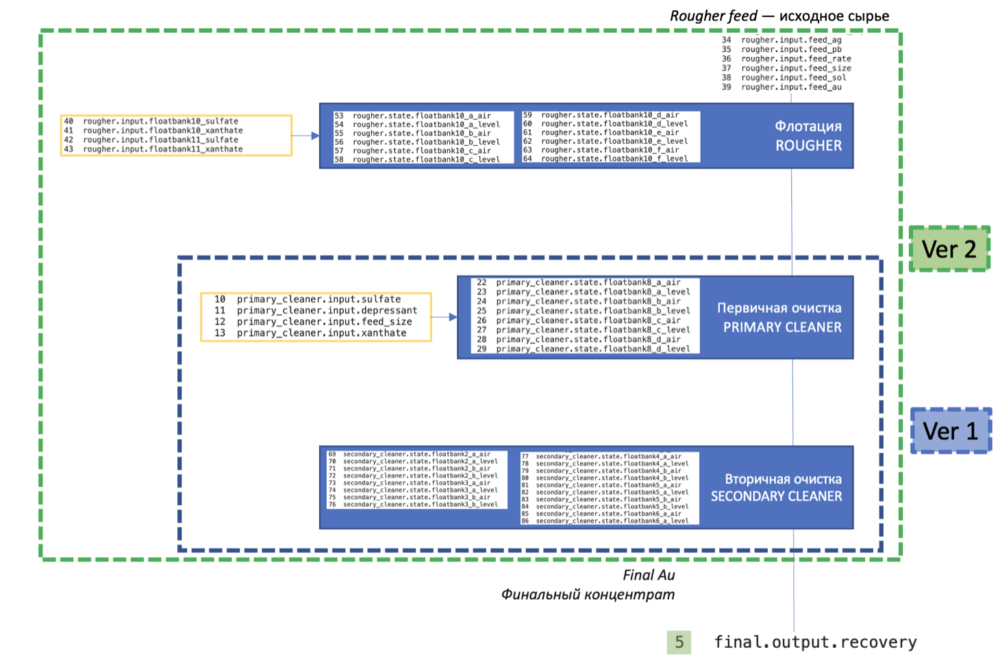

In [29]:
cleaner_features_columns = [
       # параметры реагентов
       'primary_cleaner.input.sulfate',
       'primary_cleaner.input.depressant', 
       'primary_cleaner.input.feed_size',
       'primary_cleaner.input.xanthate',
       # параметры очистной установки №1
       'primary_cleaner.state.floatbank8_a_air',
       'primary_cleaner.state.floatbank8_a_level',
       'primary_cleaner.state.floatbank8_b_air',
       'primary_cleaner.state.floatbank8_b_level',
       'primary_cleaner.state.floatbank8_c_air',
       'primary_cleaner.state.floatbank8_c_level',
       'primary_cleaner.state.floatbank8_d_air',
       'primary_cleaner.state.floatbank8_d_level',
       # параметры очистной установки №2 
       'secondary_cleaner.state.floatbank2_a_air',
       'secondary_cleaner.state.floatbank2_a_level',
       'secondary_cleaner.state.floatbank2_b_air',
       'secondary_cleaner.state.floatbank2_b_level',
       'secondary_cleaner.state.floatbank3_a_air',
       'secondary_cleaner.state.floatbank3_a_level',
       'secondary_cleaner.state.floatbank3_b_air',
       'secondary_cleaner.state.floatbank3_b_level',
       'secondary_cleaner.state.floatbank4_a_air',
       'secondary_cleaner.state.floatbank4_a_level',
       'secondary_cleaner.state.floatbank4_b_air',
       'secondary_cleaner.state.floatbank4_b_level',
       'secondary_cleaner.state.floatbank5_a_air',
       'secondary_cleaner.state.floatbank5_a_level',
       'secondary_cleaner.state.floatbank5_b_air',
       'secondary_cleaner.state.floatbank5_b_level',
       'secondary_cleaner.state.floatbank6_a_air',
       'secondary_cleaner.state.floatbank6_a_level']

# выборки №1
cleaner_features_v1 = df_train[cleaner_features_columns]
cleaner_features_test_v1 = df_test[cleaner_features_columns]

# выборки №2
cleaner_features_v2 = df_train[rougher_features_columns + cleaner_features_columns]
cleaner_features_test_v2 = df_test[rougher_features_columns + cleaner_features_columns]

In [30]:
# стандартизация выборки №1

scaler = StandardScaler()
scaler.fit(df_train[cleaner_features_columns])

cleaner_features_v1[cleaner_features_columns] = scaler.transform(df_train[cleaner_features_columns])
cleaner_features_test_v1[cleaner_features_columns] = scaler.transform(df_test[cleaner_features_columns])

/Users/vladimirgavrilev/opt/anaconda3/lib/python3.9/site-packages/pandas/core/frame.py:3678: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/Users/vladimirgavrilev/opt/anaconda3/lib/python3.9/site-packages/pandas/core/frame.py:3678: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [31]:
# стандартизация выборки №2

scaler = StandardScaler()
scaler.fit(df_train[rougher_features_columns + cleaner_features_columns])

cleaner_features_v2[rougher_features_columns + cleaner_features_columns] = scaler.transform(df_train[rougher_features_columns + cleaner_features_columns])
cleaner_features_test_v2[rougher_features_columns + cleaner_features_columns] = scaler.transform(df_test[rougher_features_columns + cleaner_features_columns])

/Users/vladimirgavrilev/opt/anaconda3/lib/python3.9/site-packages/pandas/core/frame.py:3678: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/Users/vladimirgavrilev/opt/anaconda3/lib/python3.9/site-packages/pandas/core/frame.py:3678: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Формирование таргетов

In [32]:
df_test = df_test.merge(
    df_full.loc[:,['date','rougher.output.recovery', 'final.output.recovery']], 
    how='left', 
    on = 'date')

In [33]:
# тестовая выборка 
rougher_target_test = df_test['rougher.output.recovery']
cleaner_target_test = df_test['final.output.recovery']

In [34]:
# обучающая выборка 
rougher_target = df_train['rougher.output.recovery']
cleaner_target = df_train['final.output.recovery']

### Обучение линейной модели 

В связи с тем, что данные непрерывные будем обучать обычную линейную регрессию

Обучение модели прогноза эффективности обогащения чернового концентрата по метрике SMAPE

In [35]:
model_rougher = LinearRegression()
model_rougher.fit(rougher_features, rougher_target)

scores = cross_val_score(model_rougher, rougher_features, rougher_target, cv = 10, scoring = scorer)

final_score = sum(scores) / len(scores)
print('Средняя оценка качества модели:', final_score)

Средняя оценка качества модели: -5.944320869063693


Обучение модели прогноза эффективности обогащения финального концентрата по метрике SMAPE на выборке №1 (фичи очистных установок)

In [36]:
model_cleaner_v1 = LinearRegression()
model_cleaner_v1.fit(cleaner_features_v1, cleaner_target)

scores = cross_val_score(model_cleaner_v1, cleaner_features_v1, cleaner_target, cv = 10, scoring = scorer)

final_score = sum(scores) / len(scores)
print('Средняя оценка качества модели:', final_score)

Средняя оценка качества модели: -9.955176915142381


Обучение модели прогноза эффективности обогащения финального концентрата по метрике SMAPE на выборке №2 (фичи очистных и флотационной установок)

In [37]:
model_cleaner_v2 = LinearRegression()
model_cleaner_v2.fit(cleaner_features_v2, cleaner_target)

scores = cross_val_score(model_cleaner_v2, cleaner_features_v2, cleaner_target, cv = 10, scoring = scorer)

final_score = sum(scores) / len(scores)
print('Средняя оценка качества модели:', final_score)

Средняя оценка качества модели: -10.397293625818516


Лучше всего модель спрогнозировала результаты на выборке №1

### Обучение константной модели (DummyRegressor)

In [38]:
from sklearn.dummy import DummyRegressor

model_rougher_dummy = DummyRegressor(strategy = 'mean')
model_rougher_dummy.fit(rougher_features, rougher_target)

scores = cross_val_score(model_rougher_dummy, rougher_features, rougher_target, cv = 10, scoring = scorer)

final_score = sum(scores) / len(scores)
print('Средняя оценка качества модели:', final_score)

Средняя оценка качества модели: -7.7385896347953915


Результаты хуже, чем у линейной регресии. Дальше не будем развивать константную модель

### Модель RandomForestRegressor

In [39]:
param_grid   = {
                'max_depth': range (3, 6), 
                'max_features': (np.linspace(1, rougher_features.shape[1], 4)).astype(int), # число признаков, по которым ищется разбиение.
                'min_samples_leaf': range(1, 3), # минимальное число объектов в листе. Можно задать числом или процентом от общего числа объектов (по дефолту — 1)
                'min_samples_split': range(2, 3), # минимальное количество объектов, необходимое для разделения внутреннего узла. Можно задать числом или процентом от общего числа объектов (по дефолту — 2)
                'n_estimators': [3, 10, 30]}    #число деревьев в "лесу" (по дефолту – 10)

rf = RandomForestRegressor(random_state = 12345)
grid_search_rougher = GridSearchCV(estimator = rf, param_grid = param_grid, 
                          cv = 3, n_jobs = -1, verbose = 2, scoring = scorer)

grid_search_rougher.fit(rougher_features, rougher_target)

Fitting 3 folds for each of 72 candidates, totalling 216 fits


GridSearchCV(cv=3, estimator=RandomForestRegressor(random_state=12345),
             n_jobs=-1,
             param_grid={'max_depth': range(3, 6),
                         'max_features': array([ 1,  8, 15, 22]),
                         'min_samples_leaf': range(1, 3),
                         'min_samples_split': range(2, 3),
                         'n_estimators': [3, 10, 30]},
             scoring=make_scorer(smape_score, greater_is_better=False),
             verbose=2)

In [40]:
grid_search_rougher.best_params_

{'max_depth': 4,
 'max_features': 15,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'n_estimators': 3}

In [41]:
grid_search_rougher.best_score_

-7.466551243217911

In [42]:
param_grid   = {
                'max_depth': range (3, 6), 
                'max_features': (np.linspace(1, cleaner_features_v1.shape[1], 4)).astype(int), # число признаков, по которым ищется разбиение.
                'min_samples_leaf': range(1, 3), # минимальное число объектов в листе. Можно задать числом или процентом от общего числа объектов (по дефолту — 1)
                'min_samples_split': range(2, 3), # минимальное количество объектов, необходимое для разделения внутреннего узла. Можно задать числом или процентом от общего числа объектов (по дефолту — 2)
                'n_estimators': [3, 10, 30]}    #число деревьев в "лесу" (по дефолту – 10)

rf = RandomForestRegressor(random_state = 12345)
grid_search_cleaner = GridSearchCV(estimator = rf, param_grid = param_grid, 
                          cv = 3, n_jobs = -1, verbose = 2, scoring = scorer)

grid_search_cleaner.fit(cleaner_features_v1, cleaner_target)

Fitting 3 folds for each of 72 candidates, totalling 216 fits


GridSearchCV(cv=3, estimator=RandomForestRegressor(random_state=12345),
             n_jobs=-1,
             param_grid={'max_depth': range(3, 6),
                         'max_features': array([ 1, 10, 20, 30]),
                         'min_samples_leaf': range(1, 3),
                         'min_samples_split': range(2, 3),
                         'n_estimators': [3, 10, 30]},
             scoring=make_scorer(smape_score, greater_is_better=False),
             verbose=2)

In [43]:
grid_search_cleaner.best_params_

{'max_depth': 3,
 'max_features': 1,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'n_estimators': 30}

In [44]:
grid_search_cleaner.best_score_

-10.839834754013978

Мы обучили три модели. По метрике sMAPE наилучшие результаты получены на модели линейной регрессии

### Проверка на тестовой выборке

Проверим обученные модели линейной регрессии на тестовой выборке

In [45]:
rougher_target_predict = model_rougher.predict(rougher_features_test)
score_rougher = smape_score(rougher_target_predict, rougher_target_test)

print('Средняя оценка качества модели:', score_rougher)

Средняя оценка качества модели: 8.071317779193498


In [46]:
cleaner_target_predict = model_cleaner_v1.predict(cleaner_features_test_v1)
score_final = smape_score(cleaner_target_predict, cleaner_target_test)

print('Средняя оценка качества модели:', score_final)

Средняя оценка качества модели: 9.653553547933388


In [47]:
SMAPE = 0.25 * abs(score_rougher) + 0.75 * abs(score_final)
SMAPE

9.257994605748415

[CV] END max_depth=3, max_features=1, min_samples_leaf=1, min_samples_split=2, n_estimators=10; total time=   0.1s
[CV] END max_depth=3, max_features=1, min_samples_leaf=2, min_samples_split=2, n_estimators=30; total time=   0.2s
[CV] END max_depth=3, max_features=8, min_samples_leaf=1, min_samples_split=2, n_estimators=30; total time=   0.6s
[CV] END max_depth=3, max_features=15, min_samples_leaf=1, min_samples_split=2, n_estimators=30; total time=   1.0s
[CV] END max_depth=3, max_features=22, min_samples_leaf=1, min_samples_split=2, n_estimators=30; total time=   1.4s
[CV] END max_depth=4, max_features=1, min_samples_leaf=2, min_samples_split=2, n_estimators=30; total time=   0.1s
[CV] END max_depth=4, max_features=8, min_samples_leaf=1, min_samples_split=2, n_estimators=3; total time=   0.1s
[CV] END max_depth=4, max_features=8, min_samples_leaf=1, min_samples_split=2, n_estimators=30; total time=   0.6s
[CV] END max_depth=4, max_features=15, min_samples_leaf=1, min_samples_split=2,

## Вывод

Мы разобрались с процессом обогащения драгоценных металлов. Обучили модель с помощью линейной регрессии и получили на метрике симметричного среднего абсолютного отклонения (sMAPE)  score в 9%, что достаточно хороший результат при граничном критерии метрики в 15% от бизнеса. Теперь мы можем прогнозировать эффективность обогащения и определять ботлнеки для оптимизации производства.